# Super Triangulation 
#### Owned by: Christos Antoniou

This is the implementation of the Super Triangulation method. 
The main steps followed for the implementation of the method are:
    1. Get the 2D detections and pose estimation from the JSON files.
    2. Make sure that SuperGlue is running after the modification of the initial source code has been completed
    3. Ensure that Camera Calibration works and is accurate
    4. Implement the color deviation criterion and the overall matching score criterion
    5. Get correct player boxes correspondences using this criterion
    6. In essence, get the corresponding player poses across different views from the layer box-pose association
    7. Triangulate 2D corresponding piints of player poses to get 3D poses
    8. Try this for both 2 view or 3 view triangulation (3 view gives decent results)
    9. Make sure that the visualization of the pitch works
    10. Visualization of the 3D points and hence the player poses using the "3d.py" source code

### SuperGlue Demo
These are some basic function testing, to make sure that the initial SuperGlue and the modified version work as planned
If you wish you actually skip this.

In [9]:
!python ./match_pairs.py  --superglue outdoor --max_keypoints 2048 --nms_radius 3  --resize_float --input_dir assets/sample/ --input_pairs assets/sample.txt --output_dir sample_match_pairs --viz

Namespace(cache=False, eval=False, fast_viz=False, force_cpu=False, input_dir='assets/sample/', input_pairs='assets/sample.txt', keypoint_threshold=0.005, match_threshold=0.2, max_keypoints=2048, max_length=-1, nms_radius=3, opencv_display=False, output_dir='sample_match_pairs', resize=[640, 480], resize_float=True, show_keypoints=False, shuffle=False, sinkhorn_iterations=20, superglue='outdoor', viz=True, viz_extension='png')

Traceback (most recent call last):
  File "./match_pairs.py", line 267, in <module>
    print("The image is ", image1.shape)
AttributeError: 'NoneType' object has no attribute 'shape'



Will resize to 640x480 (WxH)
Running inference on device "cuda"
Loaded SuperPoint model
Loaded SuperGlue model ("outdoor" weights)
Looking for data in directory "assets\sample"
Will write matches to directory "sample_match_pairs"
Will write visualization images to directory "sample_match_pairs"
The image1 is  [[106. 106. 106. ... 111. 111. 111.]
 [106. 106. 106. ... 111. 111. 111.]
 [106. 106. 106. ... 111. 111. 111.]
 ...
 [116. 116. 116. ... 125. 125. 125.]
 [116. 116. 116. ... 125. 125. 125.]
 [116. 116. 116. ... 125. 125. 125.]]
The image is  (480, 640)
The input1 is tensor([[[[0.4157, 0.4157, 0.4157,  ..., 0.4353, 0.4353, 0.4353],
          [0.4157, 0.4157, 0.4157,  ..., 0.4353, 0.4353, 0.4353],
          [0.4157, 0.4157, 0.4157,  ..., 0.4353, 0.4353, 0.4353],
          ...,
          [0.4549, 0.4549, 0.4549,  ..., 0.4902, 0.4902, 0.4902],
          [0.4549, 0.4549, 0.4549,  ..., 0.4902, 0.4902, 0.4902],
          [0.4549, 0.4549, 0.4549,  ..., 0.4902, 0.4902, 0.4902]]]],
       

In [10]:
'''For each keypoint in keypoints0, the matches array indicates 
    the index of the matching keypoint in keypoints1,
    or -1 if the keypoint is unmatched. '''
import numpy as np
path = 'sample_match_pairs/cam1_right_matches.npz'
npz = np.load(path)
npz.files

['keypoints0', 'keypoints1', 'matches', 'match_confidence']

In [11]:
npz['keypoints0'].shape

(692, 2)

In [12]:
npz['keypoints1'].shape

(617, 2)

In [13]:
npz['matches'].shape

(692,)

In [14]:
np.sum(npz['matches']>-1)

74

In [15]:
np.sum(npz['match_confidence']>0.5)

8

### Calibration 
These are the basic provided calibration functions. The source code is given from the supervisors

In [16]:
import math
import numpy as np

def Rx(theta):
    theta = np.deg2rad(theta)
    rcos = math.cos(theta)
    rsin = math.sin(theta)
    A = np.array([[1, 0, 0],
                  [0, rcos, -rsin],
                  [0, rsin, rcos]])
    return A


def Ry(theta):
    theta = np.deg2rad(theta)
    rcos = math.cos(theta)
    rsin = math.sin(theta)
    #A = np.array([[rcos, 0, rsin],
    #              [0, 1, 0],
    #              [-rsin, 0, rcos]])
    A = np.array([[rcos, 0, -rsin],
                  [0, 1, 0],
                  [rsin, 0, rcos]])
    return A



def calibrate(calib_txtfile):

    data = np.genfromtxt(calib_txtfile, delimiter=',',usecols=(1,2,3,4,5,6))

    image_height, image_width = 1080,1920
    cx,cy = image_width/2., image_height/2.

    theta, phi, f, Cx, Cy, Cz = data[0]
    R = Rx(phi).dot(Ry(theta).dot(np.array([[1,0,0],[0,-1,0],[0,0,-1]])))
    T = -R.dot(np.array([[Cx], [Cy], [Cz]]))
    A = np.eye(3, 3)
    A[0, 0], A[1, 1], A[0, 2], A[1, 2] = f, f, cx, cy

In [17]:
path = 'assets/sample/CAM1/calib.txt'
calibrate(path)

In [18]:
path = 'assets/sample/RIGHT/calib.txt'
calibrate(path)

### Openpose 3D reconstruction
This assumes that there is another repository that has the OpenPose code
If you cannot run this code, do not worry, the 2D detections and pose estimations are already saved under JSON files
JSON files actually hold the AlphaPose detections extracted from Aly El Hakie

In [21]:
import os
home = os.getcwd()
%cd ../OpenPose3Dreconstruction(Old Attempt)/openpose
print(home)

D:\Desktop\3D Vision\OpenPose3Dreconstruction(Old Attempt)\openpose
D:\Desktop\3D Vision\SuperTriangulation


In [22]:
!bin\OpenPoseDemo.exe   --image_dir sample_images/ --3d_views 2 --camera_parameter_path "models/cameraParameters/my_cameras/" --3d --frame_undistort --number_people_max 1 --write_json 3d_reconstruction_sample/  --output_resolution 640x360 --write_video_3d 3d_reconstruction_sample/video_3d.avi --write_video_fps 30
%cd -

Starting OpenPose demo...
Configuring OpenPose...
Starting thread(s)...
Auto-detecting all available GPUs... Detected 1 GPU(s), using 1 of them starting at GPU 0.
D:\Desktop\3D Vision\SuperTriangulation


#### From this point onwards the real implementation of Super Triangulation method starts

### Get Detections

In [23]:
import numpy as np
import cv2
import json
#Get frame0 for all 3 views
cam1_path = './assets/sample/CAM1/frame0.png'
right_path = './assets/sample/RIGHT/frame0.png'
left_path = './assets/sample/LEFT/frame0.png'
target_frame = cam1_path.split('/')[-1]

cam1_frame = cv2.imread(cam1_path)
right_frame = cv2.imread(right_path)
left_frame = cv2.imread(left_path)

#Get their gray scale equivalent that will be used in SuperGlue
cam1_frame_gs = cv2.imread(cam1_path, cv2.IMREAD_GRAYSCALE)
right_frame_gs = cv2.imread(right_path, cv2.IMREAD_GRAYSCALE)
left_frame_gs = cv2.imread(left_path, cv2.IMREAD_GRAYSCALE)

print('The size of the CAM1 image is ', cam1_frame.shape)
print("The size of RIGHT image is ", right_frame.shape)
print("The size of LEFT image is ", left_frame.shape)
print("The target frame is ", target_frame)


The size of the CAM1 image is  (1080, 1920, 3)
The size of RIGHT image is  (1080, 1920, 3)
The size of LEFT image is  (1080, 1920, 3)
The target frame is  frame0.png


### Green Pitch filtering

In [24]:
import cv2
import numpy as np
def remove_pitch(img , img_path=0):
    '''
    This is a function that inputs an img if an img_path is given
    and returns the img_array after the green mask has been applied
    By default the function inputs an image array of shape (h,w,3)
    It also returns the mask of the image
    '''
    if img_path!=0:
        ## Read
        img = cv2.imread(img_path)

    ## convert to hsv
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    #mask of green color
    mask = cv2.inRange(hsv, (36, 25, 25), (70, 255,255))

    ## if green detected, mask> 0
    imask = mask>0
    img[imask] = 0
    #green = np.zeros_like(img, np.uint8)
    #green[imask] = img[imask] #wherever you have a matching index 
    
    return img, imask

### Image with green pitch mask

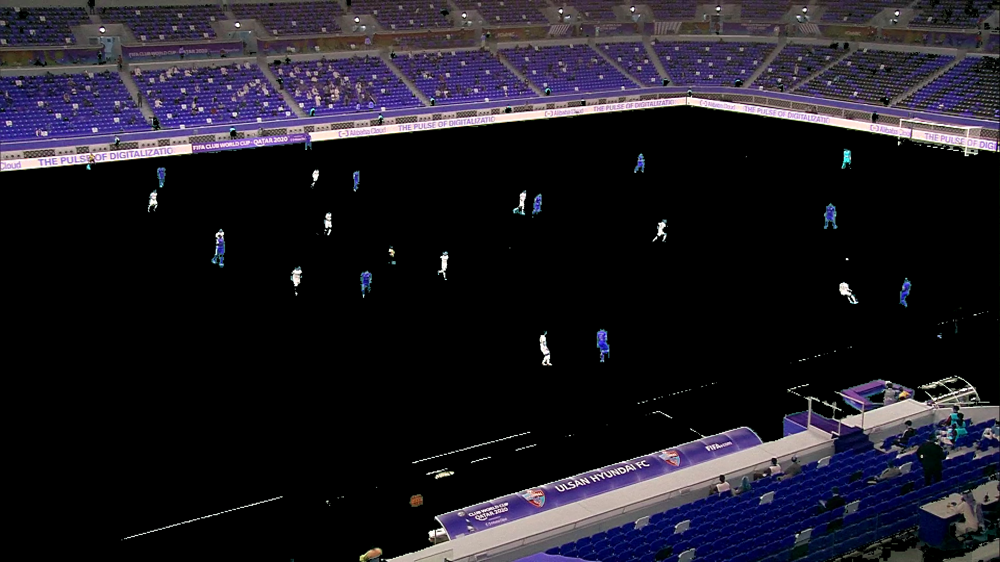

In [25]:
from PIL import Image
cam1_frame_masked,_ = remove_pitch( 0 , cam1_path)
right_frame_masked,_ = remove_pitch( 0 , right_path)
left_frame_masked, _ = remove_pitch( 0 , left_path)
display(Image.fromarray(left_frame_masked, 'RGB'))

### Main methods

In [26]:
import ipyplot
from PIL import Image
def get_bbox_coords(top_x ,top_y , w , h):
    top_left = (int(top_x) , int(top_y))
    top_right = (int(top_x+w) , int(top_y))
    bottom_right = (int(top_x+w), int(top_y+h))
    bottom_left = (int(top_x), int(top_y+h))
    return [top_left , top_right , bottom_right, bottom_left]

def get_cropped_image_gs(bbox_coords , img):
    x_left = bbox_coords[0]
    x_right = bbox_coords[0]+bbox_coords[2]
    y_top = bbox_coords[1]
    y_down = bbox_coords[1]+bbox_coords[3]
    #print(img.shape) # remember that the image is (h , w)
    return img[int(y_top):int(y_down) , int(x_left):int(x_right)]

def plot_images(img1 , img2):
    images_list = [img1, img2]
    ipyplot.plot_images(images_list, max_images=20, img_width=40)
    
def display_img(img_array):
    image = Image.fromarray(img_array , 'RGB')
    display(image)

def get_2D_points(keypoints_and_confidence):
    '''Input an array of sequential points with the 2 keypoint coordinates and the respective confidence
       and return an array of shape (N,2) corresponding to the keypoints
    '''
    #print("Input list with keypoints and confidences", '\n',keypoint)
    keypoints = np.delete(keypoints_and_confidence, np.arange(2, len(keypoints_and_confidence), 3))
    #print("Before arrangmenet to 2D points", '\n',keypoints)
    x = np.array(keypoints[0::2])#get x coordinate
    y = np.array(keypoints[1::2]) #get y coordinate of point
    points = np.vstack((x, y)).T
    #print("After arrangement to 2D keypoints",'\n',points)
    #print("Number of 2D points of the full skeleton", points.shape[0]) 
    return points



#Draw correspondence points
def draw_points(image, points):
    '''Inputs: img array & 2D points numpy array with shape (N,2)
       and it returns an img array with keypoints drawn'''
    img = image.copy()
    int_points = points.astype(int)
    '''
    #This method is for when keypoints_and_confidence list is fed as input
    x = points[0::3] #get x coordinate
    y = points[1::3] #get y coordinate of point
    x_int = list(map(int,x)) #make int
    y_int = list(map(int,y))
    points = zip(x_int,y_int) #merge together as points
    '''
    array_of_tuples = map(tuple, int_points)
    points = tuple(array_of_tuples)
    c=0
    for point in points:
        img = cv2.circle(img, point, radius=2, color=(255, 0, 0), thickness=-1)
        c=c+1
    #print("Number of keypoints",c)
    return img


def draw_skeletons(img_array, keypoints ):
    '''
    Inputs the image color array with the respective pose keypoints just as keypoints
    and returns an image array with the connected keypoints (full skeleton) drawn on image
    '''
    image = img_array.copy()
    int_points = keypoints.astype(int) #convert to acceptable int array
    array_of_tuples = map(tuple, int_points) #make all point --> tuples
    keypoints = tuple(array_of_tuples) #make tuple array of tuples
    l_pair = [
                (17, 0), (0,1),(0, 2), (1, 3), (2, 4), (0,18),  # Head
                (5, 18), (6,18),(7, 5),(7,9), (8, 10), (8,6),
                (11, 19), (12,19),(11, 13),(12,14),
                (14, 16), (25, 16),  # Body
                (23, 25), (21, 25), (11, 13), (13, 15),
                (24,15),(24,20),(24,22)
    ]
    num_pairs = len(l_pair) #get number of pairs
    
    for index in range(0 , num_pairs): 
        if index == len(keypoints) -1:
            break
        i_point, i_next = l_pair[index]
        next_point = keypoints[i_next] #next point to be connected with the current point with a line
        current_point = keypoints[i_point]
        cv2.line(image, current_point, next_point, [255, 30, 0], 2) 
    return image


def get_keypoints(correspondence_list):
    '''Inputs a correspondence list for a specific detection and returns an numpy array of the keypoints
    '''
    keypoints_and_scores = correspondence_list[::3]
    num_points = int(len(keypoints1)/2)
    keypoints = []
    for index in range(0,num_points):
        start = index*2
        end = start+2
        point = keypoints_and_scores[start:end]
        print(point)
        keypoints.append(point)
        
    return np.array(keypoints)

### Color Deviation Score

In [27]:
import numpy.ma as ma
def color_deviation_score(image1, image2):
    '''
    This is a function that inputs 2 image arrays (e.g 2 players) and based on the colors of the image
    it returns a color similarity score
    '''
    img1 = image1.copy()
    img2 = image2.copy()
    
    img1_array, mask1 = remove_pitch(img1)
    img2_array, mask2 = remove_pitch(img2)
    
    
    
    ## convert to hsv for better comparison
    #image1 = cv2.cvtColor(img1_array, cv2.COLOR_BGR2HSV)
    #image2 = cv2.cvtColor(img2_array, cv2.COLOR_BGR2HSV)
    image1 = img1_array.copy()
    image2 = img2_array.copy()
    

    #get the average R, G and B channel value for the image 1 masked arrays
    h_mean1 = np.mean(np.ma.array(image1[:,:,0], mask=mask1))
    s_mean1= np.mean(np.ma.array(image1[:,:,1], mask=mask1))
    v_mean1= np.mean(np.ma.array(image1[:,:,2], mask=mask1))
    
    #get the average R, G and B channel value for the image 2 masked_arrays
    h_mean2 = np.mean(np.ma.array(image2[:,:,0], mask=mask2))
    s_mean2= np.mean(np.ma.array(image2[:,:,1], mask=mask2))
    v_mean2= np.mean(np.ma.array(image2[:,:,2], mask=mask2))
    
    #calculate weighted deviation score by subtracting channel average for the 2 images
    weight = 0.3 #equal weight for all channels
    n_1 = image1.shape[0]*image2.shape[1] #total number of pixels in each image
    n_2 = image1.shape[1]*image2.shape[1]
    n_tot = n_1+n_2 # total number of pixels for both images
    w_1 = 1#n_1/n_tot
    w_2 = 1# n_2/n_tot
    total_average =abs(weight*(w_1*h_mean1-w_2*h_mean2)+weight*(w_1*s_mean1-w_2*s_mean2)+weight*(w_1*v_mean1-w_2*v_mean2))
    return total_average


### Import Alphapose Detections and Poses

In [28]:
import json
#Get the detections and poses
cam1_json_path = './alphapose_detections/CAM1.json'
left_json_path = './alphapose_detections/LEFT.json'
right_json_path =  './alphapose_detections/RIGHT.json'
json_paths = [cam1_json_path, left_json_path , right_json_path]

cam1_detections = []
left_detections = []
right_detections = []

json_contents = [cam1_detections,left_detections, right_detections]

for i,json_path in enumerate(json_paths):
    with open(json_path, 'r') as j:
        json_contents[i] = json.loads(j.read()) 
        
            
cam1_detections = json_contents[0]
left_detections = json_contents[1]
right_detections = json_contents[2]
views = ['CAM1', 'LEFT' , 'RIGHT']


# Define lists that will hold the keypoints and boxes for each view for a specific frame
CAM1_frame = []
LEFT_frame = []
RIGHT_frame = []
box_CAM1_frame = []
box_LEFT_frame = []
box_RIGHT_frame = []


camera_keypointDetections_for_target_frame  = [CAM1_frame , LEFT_frame , RIGHT_frame]
camera_boxDetections_for_target_frame = [box_CAM1_frame , box_LEFT_frame , box_RIGHT_frame]

for view_index, view_detection in enumerate(json_contents):
    
    num_detections = 0
    if view_index == 0:
        keypoints_frame  =  CAM1_frame
        boxes_frame = box_CAM1_frame
    if view_index == 1:
        keypoints_frame = LEFT_frame
        boxes_frame = box_LEFT_frame
    if view_index == 2:
        keypoints_frame = RIGHT_frame
        boxes_frame = box_RIGHT_frame
        
    for i in range(0,len(view_detection)):
        frame = view_detection[i]['image_id']
        if (frame == target_frame):
            #Get the key point and box for a specific detection in specific frame and view
            keypoints = view_detection[i]['keypoints']
            box = view_detection[i]['box']
            #Add to the list for the specific view and target frame 
            keypoints_frame.append(keypoints)
            boxes_frame.append(box)
            
            num_detections = num_detections + 1 #add a counter for the detections in each view for a specific target frame
    print('In',target_frame ,'for view',views[view_index],'=====>',num_detections, 'detections')

In frame0.png for view CAM1 =====> 18 detections
In frame0.png for view LEFT =====> 29 detections
In frame0.png for view RIGHT =====> 26 detections


### Get 2D detections/boxes for all players of the frame0 (RIGHT view)

In [29]:
# Test keypoints for frame0 and RIGHT view, the first detection
img = right_frame.copy()
counter = 0
for keypoint in RIGHT_frame:
    first_detection_right_frame0 = keypoint
    #print(first_detection_right_frame0)
    #print("Observe that the first 2 elements are the x and y position of the point on the image")
    #print("The 3rd element is the confidence of this point/limb prediction")
    #print('-------> draw points on image -------->')
    x = first_detection_right_frame0[0::3]
    y = first_detection_right_frame0[1::3]
    x_int = list(map(int,x))
    y_int = list(map(int,y))
    points = zip(x_int,y_int)
    #print("All x coordinates of the points are", points)
    if counter!=24:
        for point in points:
            img = cv2.circle(img, point, radius=2, color=(255, 0, 0), thickness=-1)
    counter = counter +1
print("The 2D pose detections are", counter)

The 2D pose detections are 26


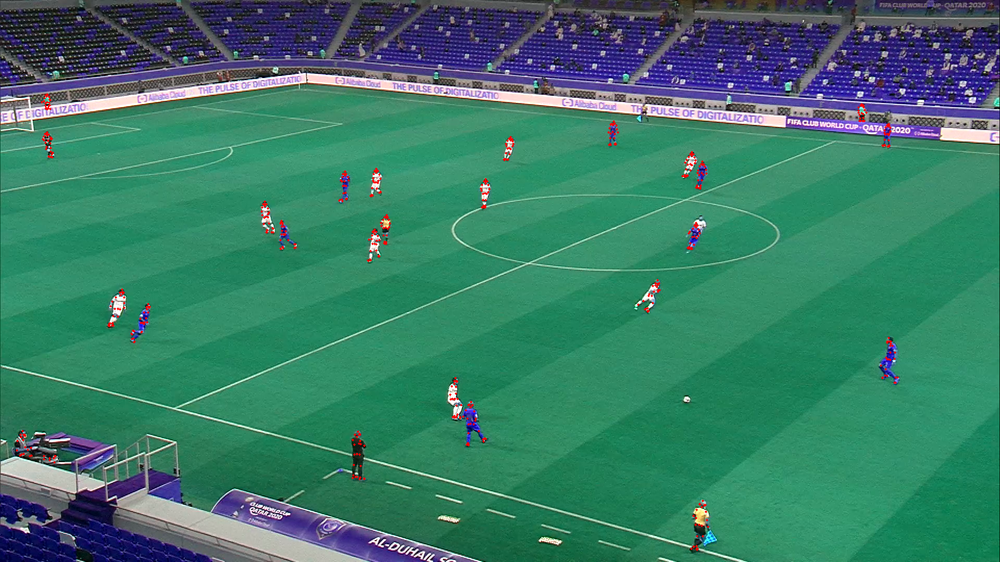

In [30]:
from PIL import Image
image = Image.fromarray(img, 'RGB')
image.save("right_view_frame0_skeletons.png")
display(image)

### Get 2D pose/skeleton/body keypoints for all players of the frame0 (RIGHT view)

In [31]:
#Test boxes for frame0 and RIGHT view, the first detection
img =  right_frame.copy()
counter = 0
for box in box_RIGHT_frame:
    first_box_detection_right_frame0 = box
    #print("The box elements of the 1st detection for frame0 right view is \n",first_box_detection_right_frame0)
    #print("Observe that the first 2 elements are the x and y position of the bbox top corner on the image")
    #print("The 3rd and 4th element are the width and height of the box")
    x_top = first_box_detection_right_frame0[0]
    y_top = first_box_detection_right_frame0[1]
    width = first_box_detection_right_frame0[2]
    height= first_box_detection_right_frame0[3]
    points = get_bbox_coords(x_top, y_top , width , height)
    #print("The bbox coordinates are points \n", points)
    #print('-------> draw points on image -------->')
    if counter!=24:
        for point in points:
            img = cv2.circle(img, point, radius=2, color=(255,0 , 0), thickness=-1)
        img = cv2.rectangle(img, points[0], points[2], color=(255,100, 0), thickness=2)
        #print(box , "with ", counter)
    counter = counter + 1 


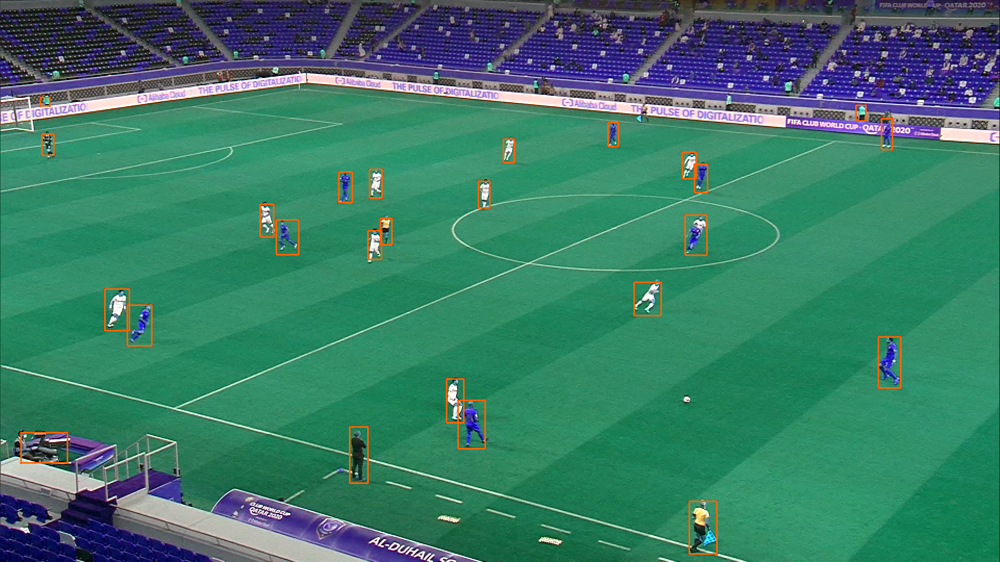

In [32]:
from PIL import Image
image = Image.fromarray(img, 'RGB')
image.save("right_view_frame0_boxes.png")
display(image)

### Associate Boxes and Skeletons(Poses)

In [33]:
# Associate a keypoint detection with a bbox
frame_dict = {}
keys = ['CAM1','LEFT', 'RIGHT']
boxes_and_keypoints_CAM1 = [x+y for x,y in zip(box_CAM1_frame, CAM1_frame)]
boxes_and_keypoints_RIGHT = [x+y for x,y in zip(box_RIGHT_frame, RIGHT_frame)]
boxes_and_keypoints_LEFT = [x+y for x,y in zip(box_LEFT_frame, LEFT_frame)]
boxes_and_keypoints = [boxes_and_keypoints_CAM1 , boxes_and_keypoints_LEFT, boxes_and_keypoints_RIGHT]

i = 0
for key in keys:
    frame_dict[key] = boxes_and_keypoints[i]
    i = i+1 

### Most probable Matching using SuperGlue

In [34]:
# Find most probable detection
from models.matching import Matching
from models.utils import read_img
import torch
from models.utils import AverageTimer
torch.set_grad_enabled(False)
timer = AverageTimer(newline=True)
 # Load the SuperPoint and SuperGlue models.
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print('Running inference on device \"{}\"'.format(device))
#Parameters for SuperGlue
nms_radius  = 4
max_keypoints = 1024
keypoint_threshold = 0.01
sinkhorn_iterations = 20
match_threshold = 0.2
resize = [640, 480]
resize_float = False
rot = 0
matching_confidence = 0.5
w_num_high_matches = 0.3
w_num_mpoints = 0.01
color_threshold = 20
w_color = 10

superglue =  'outdoor'

config = {
    'superpoint': {
        'nms_radius': nms_radius,
        'keypoint_threshold': keypoint_threshold,
        'max_keypoints': max_keypoints
    },
    'superglue': {
        'weights': superglue,
        'sinkhorn_iterations': sinkhorn_iterations,
        'match_threshold': match_threshold,
    }
}
matching = Matching(config).eval().to(device)
def matching_score(img_1 , img_2):
    ''' Inputs 2 image color arrays corresponding to the cropped players from different views
        and returns the ovr matching score for this pair of players (the higher the better)
    '''
    
    #convert image arrays to greyscale-this is is the acceptable SuperGlue format
    img_1_gs = cv2.cvtColor(img_1, cv2.COLOR_BGR2GRAY)
    img_2_gs = cv2.cvtColor(img_2, cv2.COLOR_BGR2GRAY)
    
    # Perform the matching.
    image1, inp_1 , scales1 = read_img(img_1_gs, device, resize , rot, resize_float)
    image2, inp_2, scales2 = read_img(img_2_gs, device, resize, rot, resize_float)
    pred = matching({'image0': inp_1 , 'image1': inp_2})
    pred = {k: v[0].cpu().numpy() for k, v in pred.items()}
    kpts0, kpts1 = pred['keypoints0'], pred['keypoints1']
    matches, conf = pred['matches0'], pred['matching_scores0']
    timer.update('matcher')

    # Write the matches to disk.
    out_matches = {'keypoints0': kpts0, 'keypoints1': kpts1,
                   'matches': matches, 'match_confidence': conf}
    #np.savez(str(matches_path), **out_matches)

    # Keep the matching keypoints.
    valid = matches > -1
    mkpts0 = kpts0[valid]
    mkpts1 = kpts1[matches[valid]]
    mconf = conf[valid]
    num_matches = np.sum(matches>-1)
    num_high_matches = np.sum(mconf>matching_confidence)
    avg_confidence = mconf.mean()
    

    
    #get the color confidence score 
    color_deviation = color_deviation_score(img_1,img_2)
    color_confidence = 1/color_deviation
    print("Mask Color confidence score",color_confidence)
    overall_confidence = w_num_mpoints*num_matches+avg_confidence+w_num_high_matches*num_high_matches+w_color*color_confidence
    
    print("Number of total matches ", num_matches)
    #print("The average confidence is", avg_confidence)
    print("Number of matches with confidence higher than ", matching_confidence, 'is', num_high_matches)
    #print("The overall confidence score is", overall_confidence)
    return overall_confidence

Running inference on device "cuda"
Loaded SuperPoint model
Loaded SuperGlue model ("outdoor" weights)


### Matches:RIGHT and LEFT views


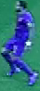
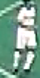


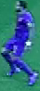
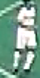

Mask Color confidence score 0.010073154093399738
Number of total matches  27
Number of matches with confidence higher than  0.5 is 7
Ovr.score 2.8600589180149147 at position 0



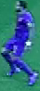
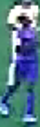


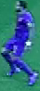
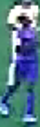

Mask Color confidence score 0.047978465158452215
Number of total matches  24
Number of matches with confidence higher than  0.5 is 6
Ovr.score 2.937380246705906 at position 1



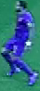
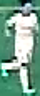


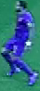
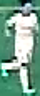

Mask Color confidence score 0.009798105104926841
Number of total matches  36
Number of matches with confidence higher than  0.5 is 8
Ovr.score 3.253767217240369 at position 2



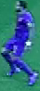
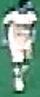


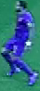
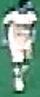

Mask Color confidence score 0.011322904535994691
Number of total matches  28
Number of matches with confidence higher than  0.5 is 6
Ovr.score 2.579456653086998 at position 3



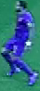
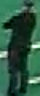


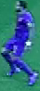
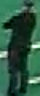

Mask Color confidence score 0.01778999131904049
Number of total matches  13
Number of matches with confidence higher than  0.5 is 2
Ovr.score 1.2563614815459652 at position 4



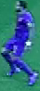
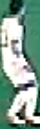


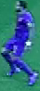
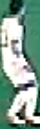

Mask Color confidence score 0.01130213957839604
Number of total matches  28
Number of matches with confidence higher than  0.5 is 6
Ovr.score 2.571854272466242 at position 5



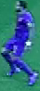
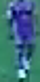


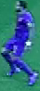
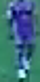

Mask Color confidence score 0.6611574637365852
Number of total matches  22
Number of matches with confidence higher than  0.5 is 11
Ovr.score 10.67092669673017 at position 6



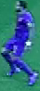
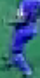


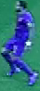
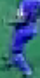

Mask Color confidence score 0.206251165787063
Number of total matches  14
Number of matches with confidence higher than  0.5 is 2
Ovr.score 3.1647770361074006 at position 7



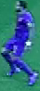
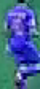


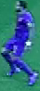
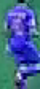

Mask Color confidence score 0.11582475709599153
Number of total matches  16
Number of matches with confidence higher than  0.5 is 3
Ovr.score 2.594719984499802 at position 8



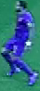
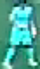


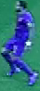
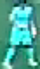

Mask Color confidence score 0.020541040001437475
Number of total matches  10
Number of matches with confidence higher than  0.5 is 0
Ovr.score 0.6024627238325815 at position 9



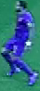
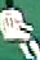


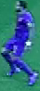
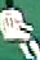

Mask Color confidence score 0.009969985047936959
Number of total matches  30
Number of matches with confidence higher than  0.5 is 3
Ovr.score 1.6137973145639948 at position 10



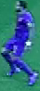
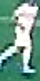


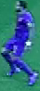
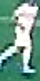

Mask Color confidence score 0.012596378557397194
Number of total matches  9
Number of matches with confidence higher than  0.5 is 0
Ovr.score 0.5295530306549198 at position 11



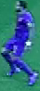
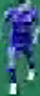


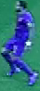
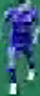

Mask Color confidence score 0.4176350012125351
Number of total matches  16
Number of matches with confidence higher than  0.5 is 4
Ovr.score 5.947002113165237 at position 12



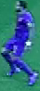
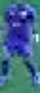


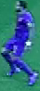
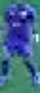

Mask Color confidence score 0.36865248399668477
Number of total matches  8
Number of matches with confidence higher than  0.5 is 4
Ovr.score 5.461115658848836 at position 13



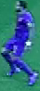
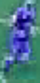


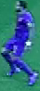
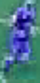

Mask Color confidence score 0.07454062422518071
Number of total matches  5
Number of matches with confidence higher than  0.5 is 0
Ovr.score 1.0851802130941686 at position 14



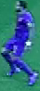
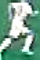


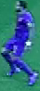
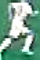

Mask Color confidence score 0.009388316082461485
Number of total matches  39
Number of matches with confidence higher than  0.5 is 12
Ovr.score 4.52092852639659 at position 15



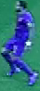
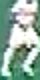


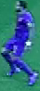
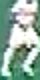

Mask Color confidence score 0.01072266599264771
Number of total matches  26
Number of matches with confidence higher than  0.5 is 7
Ovr.score 2.8672353681650793 at position 16



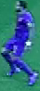
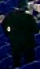


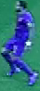
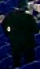

Mask Color confidence score 0.01491914100590366
Number of total matches  8
Number of matches with confidence higher than  0.5 is 0
Ovr.score 0.5267315680924076 at position 17



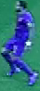


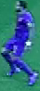

Mask Color confidence score 0.10706841772836358
Number of total matches  20
Number of matches with confidence higher than  0.5 is 7
Ovr.score 3.7954200512212424 at position 18



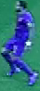
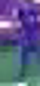


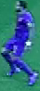
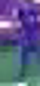

Mask Color confidence score 0.18599715233060554
Number of total matches  8
Number of matches with confidence higher than  0.5 is 6
Ovr.score 4.348237102052851 at position 19



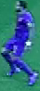
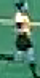


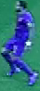
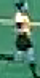

Mask Color confidence score 0.037331011258537695
Number of total matches  17
Number of matches with confidence higher than  0.5 is 0
Ovr.score 0.8782943256991618 at position 20



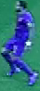
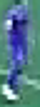


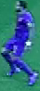
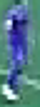

Mask Color confidence score 0.06691559135249513
Number of total matches  12
Number of matches with confidence higher than  0.5 is 3
Ovr.score 2.032734162741031 at position 21



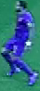
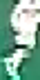


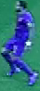
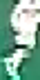

Mask Color confidence score 0.008159251308765303
Number of total matches  38
Number of matches with confidence higher than  0.5 is 13
Ovr.score 4.777464371684455 at position 22



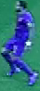
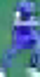


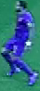
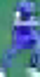

Mask Color confidence score 0.053413409671092385
Number of total matches  14
Number of matches with confidence higher than  0.5 is 5
Ovr.score 2.608975044100527 at position 23



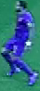
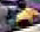


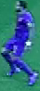
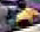

Mask Color confidence score 0.29126749815599706
Number of total matches  5
Number of matches with confidence higher than  0.5 is 0
Ovr.score 3.2578109266416813 at position 24



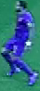
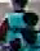


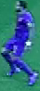
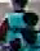

Mask Color confidence score 0.0565240259273414
Number of total matches  22
Number of matches with confidence higher than  0.5 is 0
Ovr.score 1.0656618143156806 at position 25



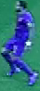
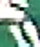


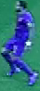
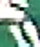

Mask Color confidence score 0.010758175034114055
Number of total matches  29
Number of matches with confidence higher than  0.5 is 5
Ovr.score 2.2591829838235014 at position 26



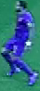


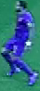

Mask Color confidence score 0.1361729968054979
Number of total matches  5
Number of matches with confidence higher than  0.5 is 0
Ovr.score 1.6783978407222917 at position 27



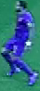
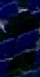


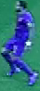
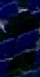

Mask Color confidence score 0.014267814399696222
Number of total matches  20
Number of matches with confidence higher than  0.5 is 5
Ovr.score 2.280501052160033 at position 28
The box that matched the image is found at index 6
For frame 0 the corresponding points for right and left view are
[1703.6602783203125, 658.9038696289062, 0.8472572565078735, 1705.5673828125, 656.0823364257812, 0.8470146059989929, 1703.6986083984375, 656.0641479492188, 0.8397555947303772, 1710.1954345703125, 656.1703491210938, 0.8156039714813232, 1708.0343017578125, 656.3565673828125, 0.5439862608909607, 1713.8394775390625, 664.242919921875, 0.7601011991500854, 1709.45703125, 664.3887329101562, 0.7326199412345886, 1718.545166015625, 677.76123046875, 0.6844015717506409, 1709.0018310546875, 677.151611328125, 0.6822414398193359, 1717.6558837890625, 689.543701171875, 0.7291005849838257, 1701.7099609375, 687.5823364257812, 0.6570765972137451, 1709.371337890625, 691.4129638671875, 0.831874430179596, 1703.625244140625,

In [35]:
#Take 1 detection for RIGHT view and check best box match for LEFT view boxes
first_detection_view1_frame0 = frame_dict['RIGHT'][2]
first_detection_view2_frame0 = frame_dict['LEFT'][0]
view2_detections = frame_dict['LEFT']

#print(first_detection_right_frame0)
view1_color_frame0 = right_frame.copy()
view2_color_frame0 = left_frame.copy()
#num_of_detections = len(frame_dict['RIGHT'])
#print("For this frame and view the number of detections is", num_of_detections)
#get colored array of 1st detection of first frame
player1_array = get_cropped_image_gs(first_detection_view1_frame0 ,  view1_color_frame0)

max_index = 0
max_matching_score = 0
counter = 0 
#Remember that SuperGlue is set this way to receive grayscale images
for detection_view2_frame0 in view2_detections:
    player2_array = get_cropped_image_gs(detection_view2_frame0, view2_color_frame0)
    crop1 = Image.fromarray(player1_array)
    crop2  = Image.fromarray(player2_array)
    plot_images(crop1, crop2)
    #print("The matching is performed for these 2 cropped images - boxes")
    #display(crop1)
    #display(crop2)
    ovr_score = matching_score(player1_array, player2_array) #feed the 2 cropped images
    print("Ovr.score",ovr_score , 'at position', counter)
    if (ovr_score >= max_matching_score):
        max_matching_score = ovr_score
        max_index = counter
    counter = counter + 1
print("The box that matched the image is found at index", max_index)
corresponding_points = [first_detection_view1_frame0[4:] , view2_detections[max_index][4:]]
print("For frame 0 the corresponding points for right and left view are")
print(corresponding_points[0])
print(corresponding_points[1])

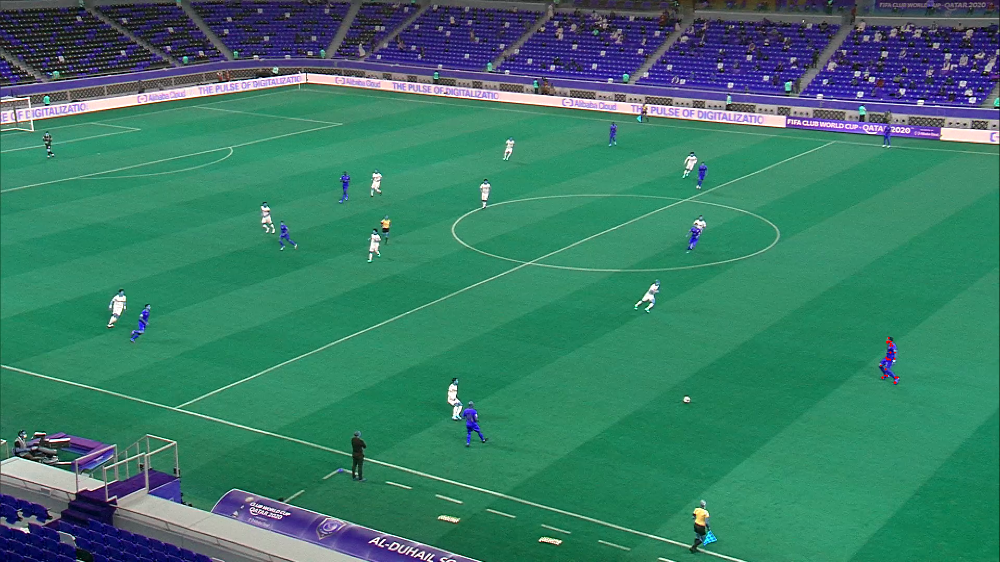

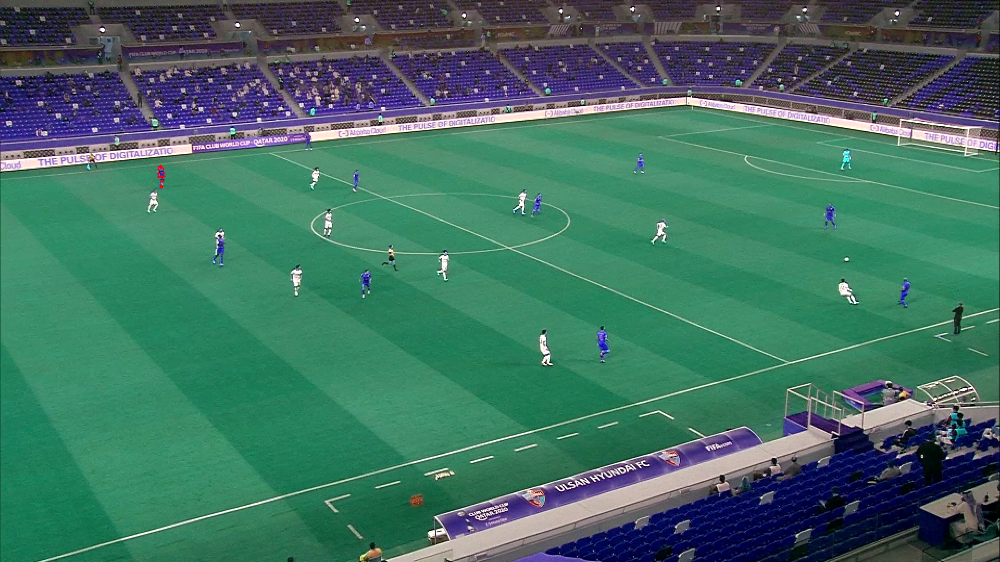

In [36]:
keypoints_view1 = get_2D_points(corresponding_points[0]) #get 2D keypoints
correspondences_view1_frame = draw_points(view1_color_frame0, keypoints_view1) #draw points on image
display_img(correspondences_view1_frame) #display image
keypoints_view2 = get_2D_points(corresponding_points[1]) #get 2D keypoints of 2nd view
correspondences_view2_frame = draw_points(view2_color_frame0, keypoints_view2) #draw points on 2nd view image
display_img(correspondences_view2_frame) #display image of view 2

### Matches: CAM1 and LEFT views


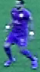
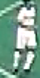


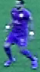
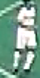

Mask Color confidence score 0.0107863272976622
Number of total matches  27
Number of matches with confidence higher than  0.5 is 3
Ovr.score 1.6241725772139877 at position 0



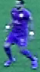
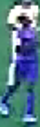


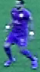
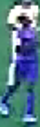

Mask Color confidence score 0.07003352810205417
Number of total matches  14
Number of matches with confidence higher than  0.5 is 5
Ovr.score 2.744904996282001 at position 1



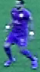
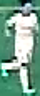


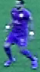
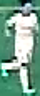

Mask Color confidence score 0.01047156150937007
Number of total matches  19
Number of matches with confidence higher than  0.5 is 1
Ovr.score 0.9254488845467495 at position 2



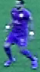
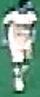


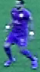
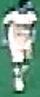

Mask Color confidence score 0.012232004008755992
Number of total matches  16
Number of matches with confidence higher than  0.5 is 4
Ovr.score 1.8580462630795032 at position 3



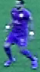
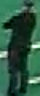


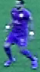
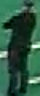

Mask Color confidence score 0.015929859863758087
Number of total matches  12
Number of matches with confidence higher than  0.5 is 1
Ovr.score 0.9258860181474685 at position 4



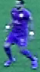
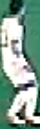


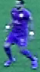
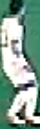

Mask Color confidence score 0.01220777438638043
Number of total matches  11
Number of matches with confidence higher than  0.5 is 0
Ovr.score 0.4931927584168744 at position 5



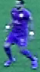
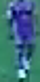


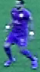
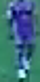

Mask Color confidence score 0.19796844150138432
Number of total matches  20
Number of matches with confidence higher than  0.5 is 4
Ovr.score 3.77728747978931 at position 6



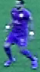
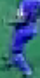


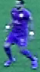
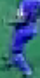

Mask Color confidence score 0.08762501219657974
Number of total matches  17
Number of matches with confidence higher than  0.5 is 1
Ovr.score 1.6654162458328323 at position 7



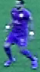
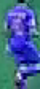


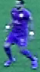
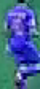

Mask Color confidence score 0.48310961679700953
Number of total matches  19
Number of matches with confidence higher than  0.5 is 0
Ovr.score 5.325775680947696 at position 8



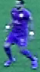
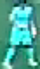


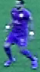
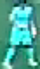

Mask Color confidence score 0.023742131430059057
Number of total matches  12
Number of matches with confidence higher than  0.5 is 1
Ovr.score 0.9693839188232956 at position 9



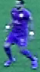
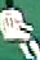


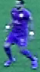
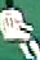

Mask Color confidence score 0.010668118216475944
Number of total matches  28
Number of matches with confidence higher than  0.5 is 3
Ovr.score 1.6422749529071758 at position 10



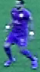
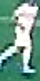


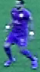
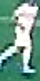

Mask Color confidence score 0.01373172027843266
Number of total matches  20
Number of matches with confidence higher than  0.5 is 0
Ovr.score 0.6246815366523534 at position 11



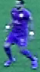
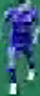


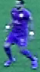
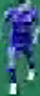

Mask Color confidence score 0.11162901415031666
Number of total matches  2
Number of matches with confidence higher than  0.5 is 0
Ovr.score 1.3913637186687702 at position 12



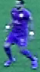
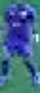


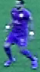
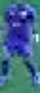

Mask Color confidence score 0.25965747913046
Number of total matches  8
Number of matches with confidence higher than  0.5 is 0
Ovr.score 2.958242739073765 at position 13



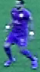
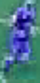


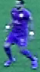
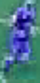

Mask Color confidence score 0.14594930246246376
Number of total matches  12
Number of matches with confidence higher than  0.5 is 2
Ovr.score 2.5493282821548497 at position 14



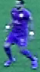
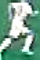


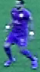
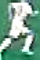

Mask Color confidence score 0.01000484584943997
Number of total matches  10
Number of matches with confidence higher than  0.5 is 1
Ovr.score 0.8408570586817012 at position 15



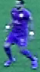
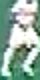


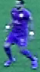
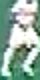

Mask Color confidence score 0.011534480408736532
Number of total matches  1
Number of matches with confidence higher than  0.5 is 0
Ovr.score 0.45220439747878377 at position 16



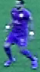
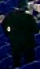


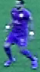
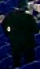

Mask Color confidence score 0.013588471033064623
Number of total matches  18
Number of matches with confidence higher than  0.5 is 7
Ovr.score 2.8534112940022163 at position 17



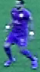


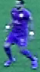

Mask Color confidence score 0.3602288365260592
Number of total matches  5
Number of matches with confidence higher than  0.5 is 0
Ovr.score 3.9862003504195123 at position 18



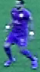
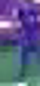


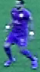
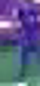

Mask Color confidence score 0.8421884132914957
Number of total matches  0
Number of matches with confidence higher than  0.5 is 0
Ovr.score nan at position 19


D:\Conda Installation\envs\gpu_python3.6\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: Mean of empty slice.
D:\Conda Installation\envs\gpu_python3.6\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)



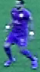
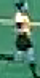


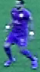
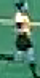

Mask Color confidence score 0.04944725078574109
Number of total matches  48
Number of matches with confidence higher than  0.5 is 13
Ovr.score 5.264325270079701 at position 20



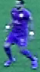
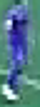


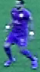
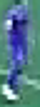

Mask Color confidence score 0.11932617266907394
Number of total matches  13
Number of matches with confidence higher than  0.5 is 6
Ovr.score 3.5893234380020793 at position 21



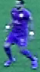
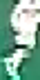


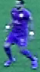
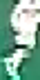

Mask Color confidence score 0.008620953075484265
Number of total matches  4
Number of matches with confidence higher than  0.5 is 0
Ovr.score 0.47434094898299206 at position 22



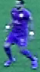
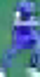


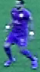
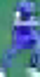

Mask Color confidence score 0.08224982072849052
Number of total matches  3
Number of matches with confidence higher than  0.5 is 0
Ovr.score 1.1921630539436119 at position 23



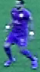
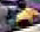


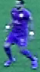
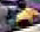

Mask Color confidence score 0.31943380683824396
Number of total matches  11
Number of matches with confidence higher than  0.5 is 1
Ovr.score 3.9397531634733056 at position 24



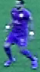
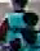


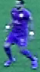
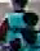

Mask Color confidence score 0.04122793093108982
Number of total matches  16
Number of matches with confidence higher than  0.5 is 3
Ovr.score 1.8136714687728732 at position 25



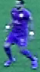
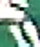


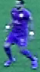
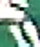

Mask Color confidence score 0.011575580081558475
Number of total matches  15
Number of matches with confidence higher than  0.5 is 3
Ovr.score 1.5521177872142815 at position 26



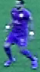


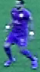

Mask Color confidence score 0.07190411952187975
Number of total matches  4
Number of matches with confidence higher than  0.5 is 0
Ovr.score 1.065056448285814 at position 27



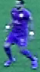
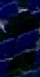


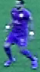
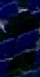

Mask Color confidence score 0.01304603721811934
Number of total matches  10
Number of matches with confidence higher than  0.5 is 4
Ovr.score 1.862577029676692 at position 28
The box that matched the image is found at index 8
For frame 0 the corresponding points for right and left view are
[1529.1680908203125, 556.6466064453125, 0.8026621341705322, 1531.091796875, 554.722900390625, 0.8575912714004517, 1527.244384765625, 554.722900390625, 0.850580632686615, 1533.9774169921875, 555.6847534179688, 0.8833185434341431, 1525.3206787109375, 554.722900390625, 0.8398136496543884, 1539.7486572265625, 567.2271728515625, 0.8393687605857849, 1521.47314453125, 564.341552734375, 0.9064992070198059, 1545.519775390625, 579.7313842773438, 0.8018849492073059, 1521.47314453125, 576.8458251953125, 0.8198156356811523, 1546.481689453125, 592.2356567382812, 0.8928905725479126, 1516.663818359375, 582.6170043945312, 0.758362352848053, 1533.9774169921875, 596.0831298828125, 0.8082669973373413, 1522.43505859375, 

In [37]:
#Take 1 detection for CAM1 view and check best box match for LEFT view boxes
first_detection_view1_frame0 = frame_dict['CAM1'][0]
first_detection_view2_frame0 = frame_dict['LEFT'][0]
view2_detections = frame_dict['LEFT']
#print(first_detection_right_frame0)

#these are the image color frames
view1_color_frame0 = cam1_frame.copy()
view2_color_frame0 = left_frame.copy()

#get colored array of 1st detection of first frame
player1_array = get_cropped_image_gs(first_detection_view1_frame0 ,  view1_color_frame0)

max_index = 0
max_matching_score = 0
counter = 0 

#Remember that SuperGlue is set this way to receive grayscale images
for detection_view2_frame0 in view2_detections:
    player2_array = get_cropped_image_gs(detection_view2_frame0, view2_color_frame0)
    crop1 = Image.fromarray(player1_array)
    crop2  = Image.fromarray(player2_array)
    plot_images(crop1, crop2)
    #print("The matching is performed for these 2 cropped images - boxes")
    #display(crop1)
    #display(crop2)
    ovr_score = matching_score(player1_array, player2_array) #feed the 2 cropped images
    print("Ovr.score",ovr_score , 'at position', counter)
    if (ovr_score >= max_matching_score):
        max_matching_score = ovr_score
        max_index = counter
    counter = counter + 1
print("The box that matched the image is found at index", max_index)
corresponding_points = [first_detection_view1_frame0[4:] , view2_detections[max_index][4:]]
print("For frame 0 the corresponding points for right and left view are")
print(corresponding_points[0])
print(corresponding_points[1])

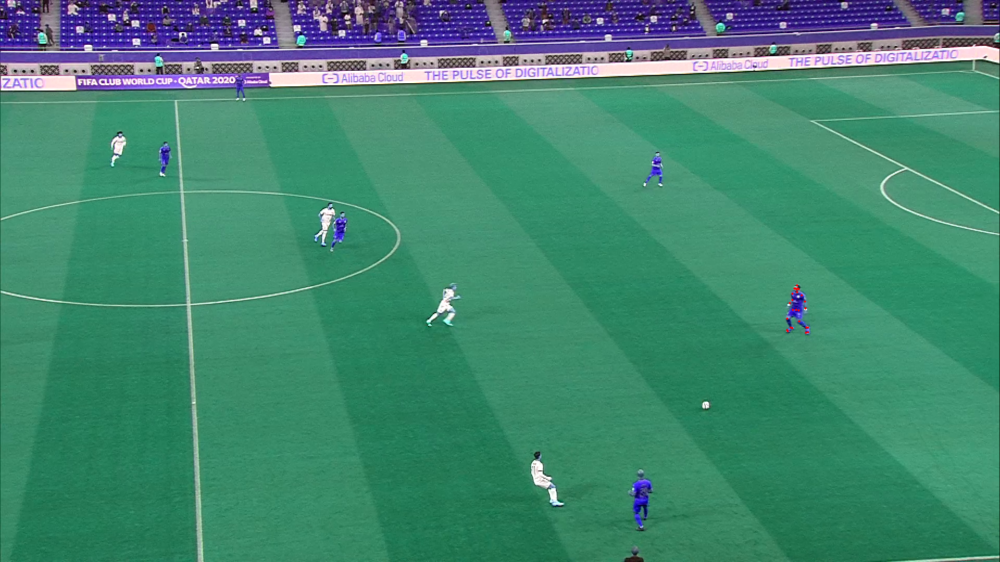

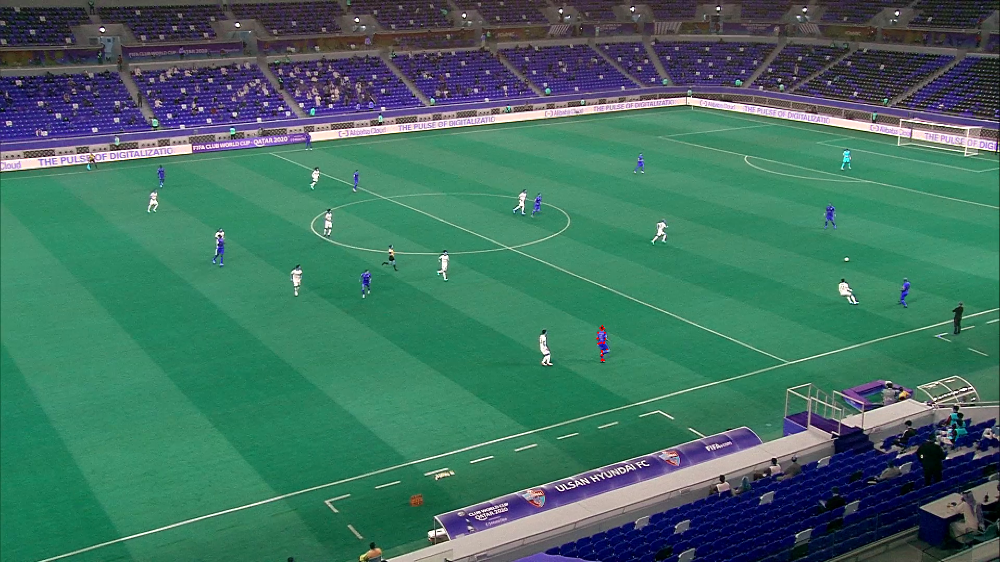

In [38]:
keypoints_view1 = get_2D_points(corresponding_points[0]) #get 2D keypoints
correspondences_view1_frame = draw_points(view1_color_frame0, keypoints_view1) #draw points on image
display_img(correspondences_view1_frame) #display image
keypoints_view2 = get_2D_points(corresponding_points[1]) #get 2D keypoints of 2nd view
correspondences_view2_frame = draw_points(view2_color_frame0, keypoints_view2) #draw points on 2nd view image
display_img(correspondences_view2_frame) #display image of view 2

### Matches: RIGHT and CAM1 views


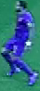
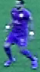


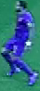
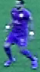

Mask Color confidence score 0.1523505598945768
Number of total matches  96
Number of matches with confidence higher than  0.5 is 21
Ovr.score 9.169609676046521 at position 0



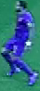
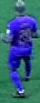


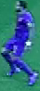
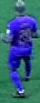

Mask Color confidence score 0.10670891341360648
Number of total matches  35
Number of matches with confidence higher than  0.5 is 7
Ovr.score 3.8731174525412166 at position 1



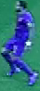
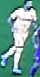


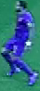
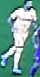

Mask Color confidence score 0.015109732717658014
Number of total matches  12
Number of matches with confidence higher than  0.5 is 1
Ovr.score 0.9053762981333824 at position 2



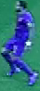
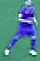


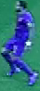
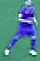

Mask Color confidence score 0.045291788512028
Number of total matches  19
Number of matches with confidence higher than  0.5 is 3
Ovr.score 1.8868530171469522 at position 3



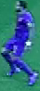
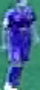


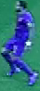
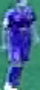

Mask Color confidence score 0.13786086559932328
Number of total matches  23
Number of matches with confidence higher than  0.5 is 7
Ovr.score 4.123960642878304 at position 4



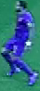
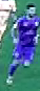


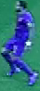
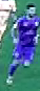

Mask Color confidence score 0.035708071574760705
Number of total matches  28
Number of matches with confidence higher than  0.5 is 8
Ovr.score 3.423150192352068 at position 5



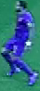
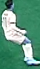


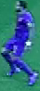
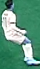

Mask Color confidence score 0.010486906053335578
Number of total matches  22
Number of matches with confidence higher than  0.5 is 13
Ovr.score 4.7406141638925785 at position 6



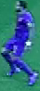
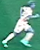


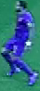
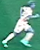

Mask Color confidence score 0.01077043870388992
Number of total matches  20
Number of matches with confidence higher than  0.5 is 4
Ovr.score 1.8785763481556899 at position 7



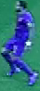
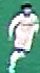


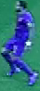
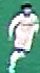

Mask Color confidence score 0.011037020049855692
Number of total matches  38
Number of matches with confidence higher than  0.5 is 5
Ovr.score 2.319899724348044 at position 8



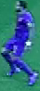
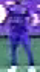


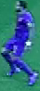
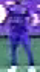

Mask Color confidence score 0.05525276520795725
Number of total matches  22
Number of matches with confidence higher than  0.5 is 6
Ovr.score 2.992615943247785 at position 9



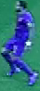


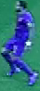

Mask Color confidence score 0.04885077662556579
Number of total matches  2
Number of matches with confidence higher than  0.5 is 0
Ovr.score 0.7248430926888397 at position 10



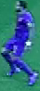
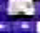


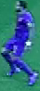
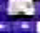

Mask Color confidence score 0.04627803848932192
Number of total matches  14
Number of matches with confidence higher than  0.5 is 5
Ovr.score 2.57832826482753 at position 11



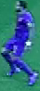
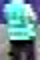


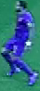
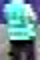

Mask Color confidence score 0.035214762594345174
Number of total matches  22
Number of matches with confidence higher than  0.5 is 3
Ovr.score 1.7970148446762855 at position 12



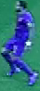
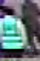


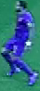
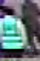

Mask Color confidence score 0.16235047806659153
Number of total matches  17
Number of matches with confidence higher than  0.5 is 4
Ovr.score 3.4202244461932594 at position 13



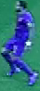
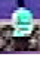


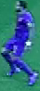
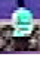

Mask Color confidence score 0.06649037089190617
Number of total matches  20
Number of matches with confidence higher than  0.5 is 0
Ovr.score 1.1565771307788029 at position 14



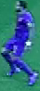
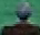


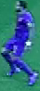
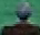

Mask Color confidence score 0.022151554924218407
Number of total matches  7
Number of matches with confidence higher than  0.5 is 1
Ovr.score 0.951359607994244 at position 15



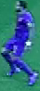
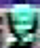


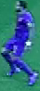
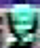

Mask Color confidence score 0.03205786766126492
Number of total matches  18
Number of matches with confidence higher than  0.5 is 4
Ovr.score 2.0668004025533535 at position 16



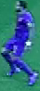
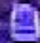


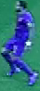
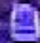

Mask Color confidence score 0.059267259782020035
Number of total matches  13
Number of matches with confidence higher than  0.5 is 3
Ovr.score 1.9748593968695776 at position 17
The box that matched the image is found at index 0
For frame 0 the corresponding points for right and left view are
[1703.6602783203125, 658.9038696289062, 0.8472572565078735, 1705.5673828125, 656.0823364257812, 0.8470146059989929, 1703.6986083984375, 656.0641479492188, 0.8397555947303772, 1710.1954345703125, 656.1703491210938, 0.8156039714813232, 1708.0343017578125, 656.3565673828125, 0.5439862608909607, 1713.8394775390625, 664.242919921875, 0.7601011991500854, 1709.45703125, 664.3887329101562, 0.7326199412345886, 1718.545166015625, 677.76123046875, 0.6844015717506409, 1709.0018310546875, 677.151611328125, 0.6822414398193359, 1717.6558837890625, 689.543701171875, 0.7291005849838257, 1701.7099609375, 687.5823364257812, 0.6570765972137451, 1709.371337890625, 691.4129638671875, 0.831874430179596, 1703.625244140625

In [39]:
#Take 1 detection for RIGHT view and check best box match for CAM1 view boxes
first_detection_view1_frame0 = frame_dict['RIGHT'][2]
first_detection_view2_frame0 = frame_dict['CAM1'][0]
view2_detections = frame_dict['CAM1']
#print(first_detection_right_frame0)
view1_color_frame0 = right_frame.copy()
view2_color_frame0 = cam1_frame.copy()

#get colored array of 1st detection of first frame
player1_array = get_cropped_image_gs(first_detection_view1_frame0 ,  view1_color_frame0)

max_index = 0
max_matching_score = 0
counter = 0 

#Remember that SuperGlue is set this way to receive grayscale images
for detection_view2_frame0 in view2_detections:
    player2_array = get_cropped_image_gs(detection_view2_frame0, view2_color_frame0)
    crop1 = Image.fromarray(player1_array)
    crop2  = Image.fromarray(player2_array)
    plot_images(crop1, crop2)
    #print("The matching is performed for these 2 cropped images - boxes")
    #display(crop1)
    #display(crop2)
    ovr_score = matching_score(player1_array, player2_array) #feed the 2 cropped images
    print("Ovr.score",ovr_score , 'at position', counter)
    if (ovr_score >= max_matching_score):
        max_matching_score = ovr_score
        max_index = counter
    counter = counter + 1
print("The box that matched the image is found at index", max_index)
corresponding_points = [first_detection_view1_frame0[4:] , view2_detections[max_index][4:]]
print("For frame 0 the corresponding points for right and left view are")
print(corresponding_points[0])
print(corresponding_points[1])

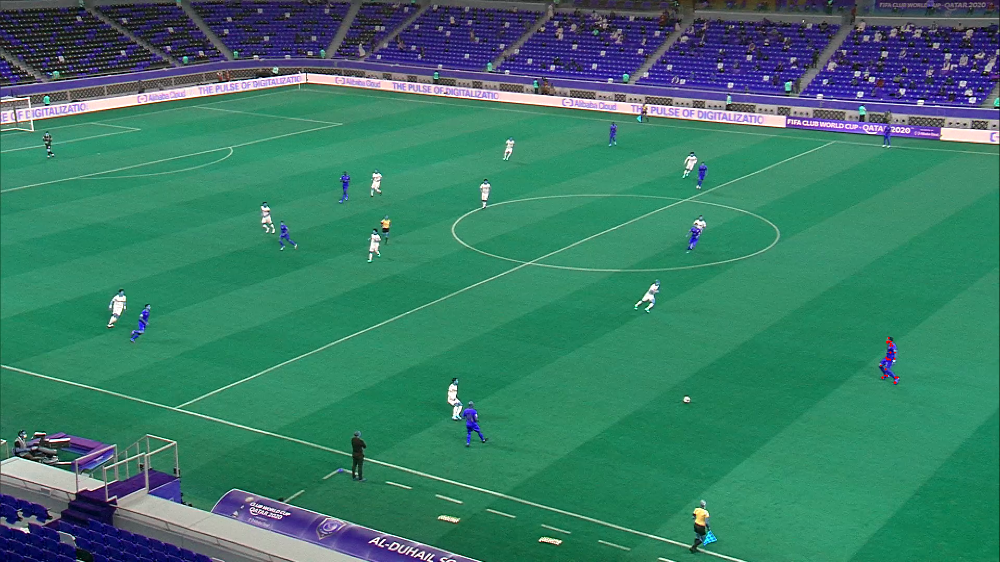

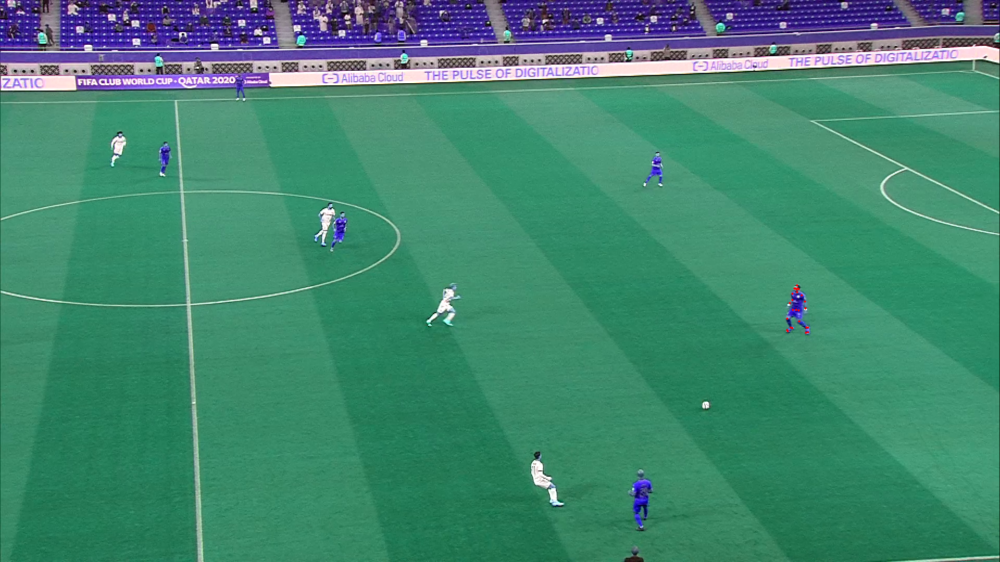

In [40]:
keypoints_view1 = get_2D_points(corresponding_points[0]) #get 2D keypoints
correspondences_view1_frame = draw_points(view1_color_frame0, keypoints_view1) #draw points on image
display_img(correspondences_view1_frame) #display image
keypoints_view2 = get_2D_points(corresponding_points[1]) #get 2D keypoints of 2nd view
correspondences_view2_frame = draw_points(view2_color_frame0, keypoints_view2) #draw points on 2nd view image
display_img(correspondences_view2_frame) #display image of view 2

#Save images to demonstrate correct correspondences
view1 = Image.fromarray(correspondences_view1_frame, 'RGB')
view2 = Image.fromarray(correspondences_view2_frame, 'RGB')
view1.save("right_view_frame0_detection0.png")
view2.save("cam1_view_frame0_detection0.png")


### Grround truth 2-view correspondences RIGHT to LEFT view frame0

In [41]:
'''the last index corresponds to the camera view index
   and the first index corresponds to the index of the detection for the respective view
'''
all_pose_correspondences = []
all_pose_correspondences.append([frame_dict['RIGHT'][0][4:], frame_dict['LEFT'][8][4:]])
all_pose_correspondences.append([frame_dict['RIGHT'][2][4:], frame_dict['LEFT'][10][4:]])
all_pose_correspondences.append([frame_dict['RIGHT'][3][4:], frame_dict['LEFT'][7][4:]])
all_pose_correspondences.append([frame_dict['RIGHT'][4][4:], frame_dict['LEFT'][0][4:]])
all_pose_correspondences.append([frame_dict['RIGHT'][5][4:], frame_dict['LEFT'][10][4:]])
all_pose_correspondences.append([frame_dict['RIGHT'][7][4:], frame_dict['LEFT'][2][4:]])
all_pose_correspondences.append([frame_dict['RIGHT'][9][4:], frame_dict['LEFT'][5][4:]])
all_pose_correspondences.append([frame_dict['RIGHT'][10][4:], frame_dict['LEFT'][14][4:]])
all_pose_correspondences.append([frame_dict['RIGHT'][14][4:], frame_dict['LEFT'][12][4:]])
                                 

### Ground truth 3-view correspondence RIGHT, LEFT, CAM1 view frame0

In [42]:
'''the last index corresponds to the camera view index
   and the first index corresponds to the index of the detection for the respective view
'''
three_view_correspondences = []
three_view_correspondences.append([frame_dict['RIGHT'][2][4:], frame_dict['LEFT'][10][4:],frame_dict['CAM1'][0][4:]])
three_view_correspondences.append([frame_dict['RIGHT'][3][4:], frame_dict['LEFT'][7][4:],frame_dict['CAM1'] [0][4:]])

### Camera Calibration
This is code adapted to the initial supervisors coder. Aly has added some extra functions to help with better and more clear calibration

In [43]:
def Rx(theta):
    theta = np.deg2rad(theta)
    rcos = math.cos(theta)
    rsin = math.sin(theta)
    A = np.array([[1, 0, 0],
                  [0, rcos, -rsin],
                  [0, rsin, rcos]])
    return A


def Ry(theta):
    theta = np.deg2rad(theta)
    rcos = math.cos(theta)
    rsin = math.sin(theta)

    A = np.array([[rcos, 0, -rsin],
                  [0, 1, 0],
                  [rsin, 0, rcos]])
    return A

def get_camera_properties(data,frame):

    cx,cy = image_width/2., image_height/2.

    theta, phi, f, Cx, Cy, Cz = data[frame]
    R = Rx(phi).dot(Ry(theta).dot(np.array([[1,0,0],[0,-1,0],[0,0,-1]])))
    T = -R.dot(np.array([[Cx], [Cy], [Cz]]))
    K = np.eye(3, 3)
    K[0, 0], K[1, 1], K[0, 2], K[1, 2] = f, f, cx, cy
    return K, T, R

def compute_projection_matrix(K,T,R):
    P = K @ np.append(R,T, axis=1)
    return P

def compute_fundamental_matrix(P1,P2,C1):
    P1_pinv = np.linalg.pinv(P1)
    e2      = P2 @ C1
    e2_x    = np.array([[0, -e2[2], e2[1]],
                        [e2[2], 0, -e2[0]],
                        [-e2[1], e2[0], 0]])
    F       = e2_x @ P2 @ P1_pinv
    return F


In [44]:
def homogenize(x):
    return np.append(x,1)

def dehomogenize_2D(x):
    return (x/x[2])[:2]

def dehomogenize_3D(x):
    return (x/x[3])[:3]

def line_point_distance_2D(l,x): 
    #line to point distance with 2D homogeneous coordinates
    x        = x/x[2]
    distance = np.dot(l, x)/(np.sqrt(l[0]**2+l[1]**2))
    return distance

def point_point_distance_2D(x1,x2):
    #point to point distance with 2D homogeneous coordinates
    x1       = x1/x1[2]
    x2       = x2/x2[2]
    distance = np.sqrt((x1[0]-x2[0])**2+(x1[1]-x2[1])**2)
    return distance

def point_point_distance_3D(x1,x2):
    #point to point distance with 3D homogeneous coordinates
    x1       = dehomogenize_3D(x1)
    x2       = dehomogenize_3D(x2)
    distance = np.sqrt((x1[0]-x2[0])**2+(x1[1]-x2[1])**2+(x1[2]-x2[2])**2)
    return distance


def line_point_distance_3D(v,x0,x1):
    #line to point distance with 3D homogeneous coordinates
    #we have the parametric representaion for the line
    #v is the direction vector and x1 is the point on the line
    #x0 is the point we want to measure the distance
    #https://mathworld.wolfram.com/Point-LineDistance3-Dimensional.html
    x2 = x1 + 10.0*v
    x0 = dehomogenize_3D(x0)
    x1 = dehomogenize_3D(x1)
    x2 = dehomogenize_3D(x2)
    distance = np.linalg.norm(np.cross(x0-x1,x0-x2))/np.linalg.norm(x2-x1)
    return distance

def line_point_distance_3D_2(v,x0,x1):
    #line to point distance with 3D homogeneous coordinates
    #we have the parametric representaion for the line
    #v is the direction vector and x1 is the point on the line
    #x0 is the point we want to measure the distance
    #https://onlinemschool.com/math/library/analytic_geometry/p_line/


    X = v[:3]
    s = x1[:3]-x1[3]*X 
    x0 = dehomogenize_3D(x0)

    distance = np.linalg.norm(np.cross(x0-X,s))/np.linalg.norm(s)
    return distance


### Sample Calibration for CAM1, LEFT and RIGHT view

In [45]:
image_height, image_width = 1080,1920
#CAM1
data        = np.genfromtxt('./calibrations/CAM1/calib.txt',delimiter=',',usecols=(1,2,3,4,5,6))
print(data.shape)
K1,T1,R1    = get_camera_properties(data,0)
P1          = compute_projection_matrix(K1,T1,R1)
print("The projection matrix for the CAM1 is")
print(P1)
C1          = homogenize(data[0,3:])


#LEFT
data        = np.genfromtxt('./calibrations/LEFT/calib.txt',delimiter=',',usecols=(1,2,3,4,5,6))
print(data.shape)
K_L,T_L,R_L    = get_camera_properties(data,0)
P_L       = compute_projection_matrix(K_L,T_L,R_L)
print("The projection matrix for the LEFT is")
print(P_L)
C1          = homogenize(data[0,3:])


#RIGHT
data        = np.genfromtxt('./calibrations/RIGHT/calib.txt',delimiter=',',usecols=(1,2,3,4,5,6))
K_R,T_R,R_R = get_camera_properties(data,0)
P_R         = compute_projection_matrix(K_R,T_R,R_R)
print("The projection matrix for the RIGHT view is")
print(P_R)
C_R         = homogenize(data[0,3:])

(247, 6)
The projection matrix for the CAM1 is
[[ 3.17108917e+03 -2.75726890e+02 -2.85962190e+02  2.37919330e+04]
 [-7.22457641e+01 -3.07493936e+03  3.50905506e+02  3.11434916e+04]
 [ 1.93157790e-01 -2.87215510e-01 -9.38188317e-01  6.72223470e+01]]
(252, 6)
The projection matrix for the LEFT is
[[ 2.14903442e+03 -2.83569145e+02  2.60159150e+02  7.03380675e+04]
 [-3.35124822e+01 -2.03283967e+03  5.36935624e+01  3.29517709e+04]
 [ 5.05850229e-01 -2.95384526e-01 -8.10471176e-01  7.75391976e+01]]
The projection matrix for the RIGHT view is
[[ 1.73057313e+03 -2.50451043e+02 -2.14033852e+03  8.51439809e+04]
 [ 8.05999308e+01 -2.64285458e+03  1.32217290e+02  3.15105631e+04]
 [-5.02485949e-01 -2.60886503e-01 -8.24285207e-01  7.27228415e+01]]


### Triangulation of set of 2D corresponding points
This is code adapted to the initial code baseline from Mert Cokmez.
The code has been modified to suit the format of data and comments have been added to explain the inputs and outputs of each function

In [46]:

def triangulation_2_view(P1, x1s, P2, x2s):
    '''Triangulation of 2D corresponding points for the 2 views. Inputs 2D points and
       respective projection matrix for each view & return the 3D point for these 2 views
       '''
    XS = np.zeros((4, x1s.shape[1]))

    for k in range(x1s.shape[1]):
        r1 = x1s[0,k] * P1[2,:] - P1[0,:]
        r2 = x1s[1,k] * P1[2,:] - P1[1,:]

        r3 = x2s[0,k] * P2[2,:] - P2[0,:]
        r4 = x2s[1,k] * P2[2,:] - P2[1,:]

        A = np.stack((r1,r2,r3,r4))

        u, s, vh = np.linalg.svd(A)

        XS[:,k] = vh[:,-1] / vh[3, -1]
    return XS

        

def triangulation_3_view(P1, x1s, P2, x2s, P3, x3s):
    '''Triangulation of 3 views'''
    XS = np.zeros((4, x1s.shape[1]))

    for k in range(x1s.shape[1]):
        r1 = x1s[0,k] * P1[2,:] - P1[0,:]
        r2 = x1s[1,k] * P1[2,:] - P1[1,:]

        r3 = x2s[0,k] * P2[2,:] - P2[0,:]
        r4 = x2s[1,k] * P2[2,:] - P2[1,:]

        r5 = x3s[0,k] * P3[2,:] - P3[0,:]
        r6 = x3s[1,k] * P3[2,:] - P3[1,:]

        A = np.stack((r1,r2,r3,r4,r5,r6))
        

        u, s, vh = np.linalg.svd(A)

        XS[:,k] = vh[:,-1] / vh[3, -1]
    return XS

### Triangulate 2D correspondences and save 3D points

#### 2 view: Ground truth correspondences for RIGHT & LEFT view frame0

In [47]:
points = []
iterations = int(len(all_pose_correspondences[0][0])/3)
#print("Correspongin points for the 2D points for the 2 views",all_pose_correspondences[i][0])
for detection,correspondence in enumerate(all_pose_correspondences):
    
    #get keypoints with confidence
    keypoints_and_confidence1 = all_pose_correspondences[detection][0]
    keypoints_and_confidence2 = all_pose_correspondences[detection][1]
    
    x1_skeletons = get_2D_points(keypoints_and_confidence1) #get x1 2D keypoints for view 1
    x2_skeletons = get_2D_points(keypoints_and_confidence2) #get x2 2D keypoints for view 2
    
    #get number of keypoints for the skeleton
    num_skeleton_points = x1_skeletons.shape[0]
    
    for point_index in range(0,num_skeleton_points):
        
        #get each 2D point for both skeletons
        x1 = x1_skeletons[point_index] # for view 1
        x2 = x2_skeletons[point_index] # for view 2
        
        ##convert to homogenous coordinates
        x1 = np.expand_dims(np.array(x1).transpose(), axis=1)
        x2 = np.expand_dims(np.array(x2).transpose(), axis=1)

        #Triangulate to get 3D point with 2D homogenous points
        threeD_point_hom = triangulation_2_view(P_R, x1, P_L, x2)
        threeD_point =  threeD_point_hom.copy()[:3] #get the first 3 elements (last element is always 1 -homogenous)
        x = threeD_point.transpose()
        #print("3D point for each correspondence", x)
        points.append(x)
final_points = np.array(points).squeeze(axis=1)
name = '2_view_points.npy'
np.save(name, final_points)
#np.save(name, final_points.astype(int))
print("3D points for the given corresponding points are stored in", name)

3D points for the given corresponding points are stored in 2_view_points.npy


#### 3 view: Ground truth correspondences for RIGHT & LEFT view frame0

In [48]:
points = []
#print("Corresponding points 2D points for the 3 views")
for detection,correspondence in enumerate(three_view_correspondences):
    
    #get keypoints with confidence
    keypoints_and_confidence1 = three_view_correspondences[detection][0]
    keypoints_and_confidence2 = three_view_correspondences[detection][1]
    keypoints_and_confidence3 = three_view_correspondences[detection][2]
    
    x1_skeletons = get_2D_points(keypoints_and_confidence1) #get x1 2D keypoints for view 1
    x2_skeletons = get_2D_points(keypoints_and_confidence2) #get x2 2D keypoints for view 2
    x3_skeletons = get_2D_points(keypoints_and_confidence3) #get x2 2D keypoints for view 3
    
    #get number of keypoints for the skeleton
    num_skeleton_points = x1_skeletons.shape[0]
    
    for point_index in range(0,num_skeleton_points):
        
        #get each 2D point for both skeletons
        x1 = x1_skeletons[point_index] # for view 1
        x2 = x2_skeletons[point_index] # for view 2
        x3 = x3_skeletons[point_index] # for view 3
        
        ##convert to homogenous coordinates
        x1 = np.expand_dims(np.array(x1).transpose(), axis=1)
        x2 = np.expand_dims(np.array(x2).transpose(), axis=1)
        x3 = np.expand_dims(np.array(x3).transpose(), axis=1)
        

        #Triangulate to get 3D point with 2D homogenous points
        threeD_point_hom = triangulation_3_view(P_R, x1, P_L, x2, P1, x3)
        threeD_point =  threeD_point_hom.copy()[:3] #get the first 3 elements (last element is always 1 -homogenous)
        x = threeD_point.transpose()
        #print("3D point for each correspondence", x)
        points.append(x)
final_points = np.array(points).squeeze(axis=1)
name = '3_view_points.npy'
np.save(name, final_points)
#np.save(name, final_points.astype(int))
print("3D points for the given corresponding points are stored in", name)

3D points for the given corresponding points are stored in 3_view_points.npy


### Visualize 2D corresponding skeletons in 2 views 

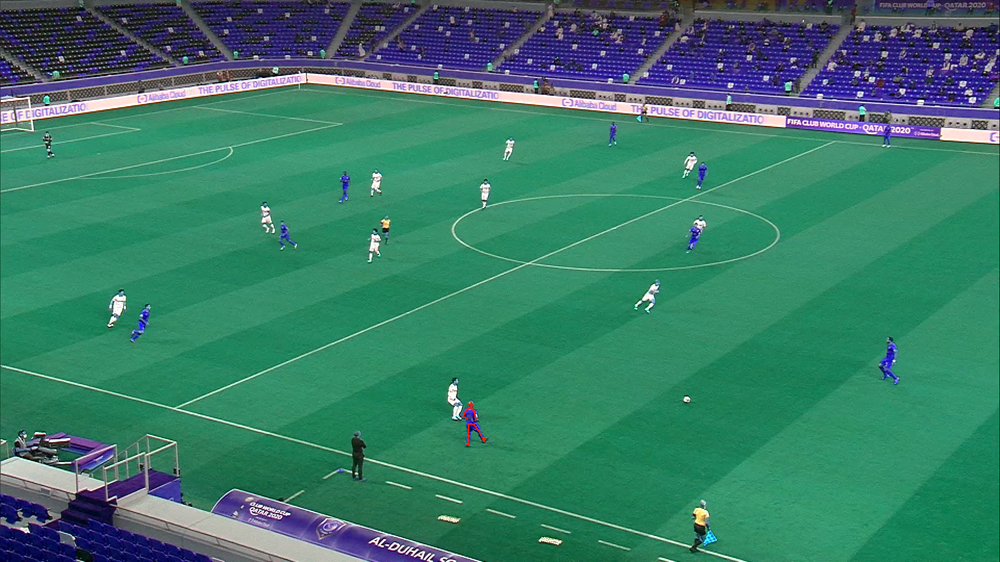

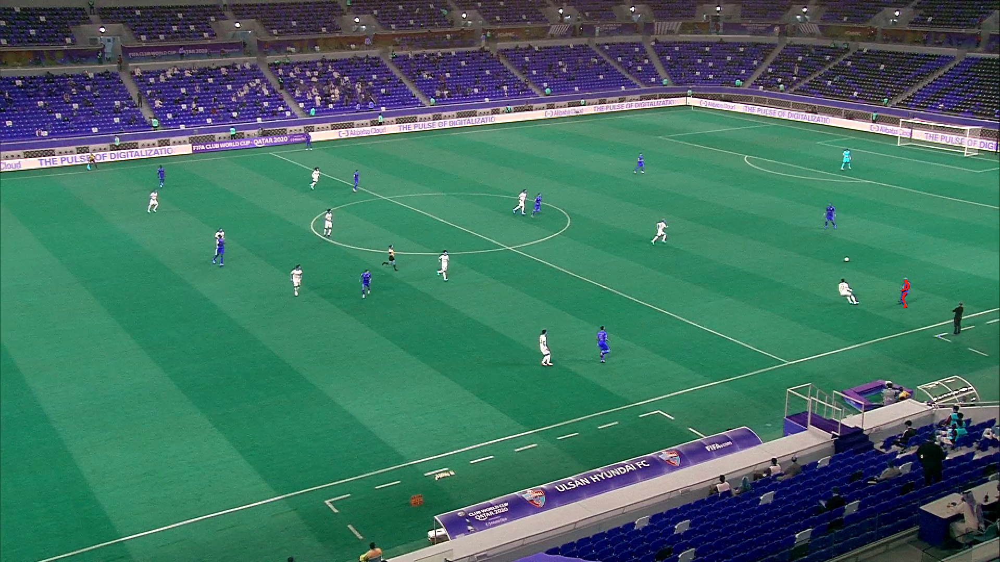

In [49]:
#get frame0 for the RIGHT and LEFT view
view1_color_frame0 = right_frame.copy()
view2_color_frame0 = left_frame.copy()

#get 2D correspondences for both views
keypoints_view1 = get_2D_points(all_pose_correspondences[2][0]) #2nd detection 1st view
keypoints_view2 = get_2D_points(all_pose_correspondences[2][1]) #2nd detection 2nd view

#Draw skeletons in both views
correspondences_view1_frame = draw_skeletons(view1_color_frame0, keypoints_view1) #correspondence with skeleton draw
correspondences_view2_frame = draw_skeletons(view2_color_frame0, keypoints_view2) #corresponding skeleton drawn on view2

display_img(correspondences_view1_frame)
display_img(correspondences_view2_frame)

### Visualize 3D points

In [50]:
import vispy
from vispy.scene import visuals, SceneCanvas
import numpy as np
import os
from vispy.color import ColorArray

x = np.array([[-27.28693368 , -0.19841904 ,0.31033562]])


class Visualizer():
    def __init__(self):
        self.canvas = SceneCanvas(keys='interactive', show=True)
        self.grid = self.canvas.central_widget.add_grid()
        self.view = vispy.scene.widgets.ViewBox(border_color='white',
                        parent=self.canvas.scene)
        self.grid.add_widget(self.view, 0, 0)

        # Point Cloud Visualizer
        self.sem_vis = visuals.Markers()
        self.view.camera = vispy.scene.cameras.TurntableCamera(up='z', azimuth=90)
        self.view.add(self.sem_vis)
        visuals.XYZAxis(parent=self.view.scene)
        
        # Object Detection Visualizer
        self.obj_vis = visuals.Line()
        self.view.add(self.obj_vis)
        self.connect = np.asarray([[0,1],[0,3],[0,4],
                                   [2,1],[2,3],[2,6],
                                   [5,1],[5,4],[5,6],
                                   [7,3],[7,4],[7,6]])
         
    def update(self, points):
        '''
        :param points: point cloud data
                        shape (N, 3)          
        '''
        #color = ColorArray(color,clip=True)
        #self.sem_vis.set_data(points,edge_color=color, size=3)
        self.sem_vis.set_data(points, size=3)
    
   
        

if __name__ == '__main__': 
    visualizer = Visualizer()
    visualizer.update(x)
    vispy.app.run()




#### If this doesn't run on notebook, execute straight from .py by executing the next cell

In [51]:
!python 3d.py

Player 3D keypoints are 
 [[ 2.72557858e+01  1.59927195e-02 -3.92942050e-01]
 [ 2.72549967e+01  1.53487876e-02 -3.91646267e-01]
 [ 2.72812822e+01  1.55432735e-02 -3.95247738e-01]
 [ 2.72626650e+01  1.50451993e-02 -3.87866401e-01]
 [ 2.72626610e+01  1.52760133e-02 -3.93266504e-01]
 [ 2.72760972e+01  1.64233450e-02 -3.81037509e-01]
 [ 2.72874389e+01  1.68512744e-02 -3.92955491e-01]
 [ 2.73280682e+01  1.84093265e-02 -3.73586903e-01]
 [ 2.73833212e+01  1.92900141e-02 -3.92645243e-01]
 [ 2.74028487e+01  2.06103644e-02 -3.72131946e-01]
 [ 2.74888503e+01  2.16350821e-02 -3.99437875e-01]
 [ 2.72847003e+01  2.18420035e-02 -3.78571402e-01]
 [ 2.74007329e+01  2.24101422e-02 -3.91121368e-01]
 [ 2.75068326e+01  2.60041567e-02 -3.83231249e-01]
 [ 2.74601036e+01  2.61381151e-02 -3.99811496e-01]
 [ 2.77103624e+01  2.68262106e-02 -3.68307257e-01]
 [ 2.76437325e+01  2.85121910e-02 -3.92098477e-01]
 [ 2.72667499e+01  1.40572795e-02 -3.93556928e-01]
 [ 2.72766119e+01  1.59183187e-02 -3.88783748e-01]
 [ 2.

### Random pitch 3D points

In [52]:
x = np.array([[0,0,0],[1,0,0],[-1,0,0],[0,3,0],[1,3,0],[-1,3,0],
              [0,-3,0],[1,-3,0],[-1,-3,0],
              [0.7,2,0],[-0.7,2,0], [0.7,-2,0],
              [-0.7,-2,0], [0.7,-3,0],[-0.7,-3,0],[0.7,3,0],[-0.7,3,0],
              [0.7,2,0],[0.7,3,0],[0.2,3,0.2],[0.2,3,0],[-0.2,3,0], [-0.2,3,0.2],
              [0.2,-3,0.2],[0.2,-3,0],[-0.2,-3,0], [-0.2,-3,0.2]])

lines = np.asarray([[0,1],[0,2], [3,4],[3,5],[6,7],[6,8]])
np.save("pitch.npy", x)